#     Estimating Counterfactual Energy Usage of Buildings with Machine Learning
<p> 
    
##    `Part-4-AllSiteIds.ipynb`

<p>
    
### by:  Steven Smiley

# Table of Contents (TOC)

* [0. Overall Purpose](#Code_Objective_0)
    * [0.1 Acknowledgments ](#Code_Objective_0_1)
    * [0.2 Background](#Code_Objective_0_2)
    * [0.3 References](#Code_Objective_0_3)
<p>
    
## Divide     
* [ `1. Part-1-Divide.ipynb`](#Code_Objective_1)<p> *Divide Data* into 16 datasets based on their `Site ID` <p>

    * [1.1: Import Libraries](#Code_Objective_1_1)
    * [1.2: Make Directories for Output Files](#Code_Objective_1_2)
    * [1.3: Import and View Data](#Code_Objective_1_3)
    * [1.4: Reduce Data Memory](#Code_Objective_1_4)
    * [1.5: Merge Data](#Code_Objective_1_5)
    * [1.6: Look at Data](#Code_Objective_1_6)
    * [1.7: Divide and Export Data](#Code_Objective_1_7)

<p>
    
## And    
* [ `2. Part-2-And.ipynb` ](#Code_Objective_2)<p> 
    *Exploratory Data Analysis* and *Cleaning* for each `Site ID`, <p> 
    repeat for all 16 sites ( `Split_Number_i` =1 to 16) <p>

    * [2.1: Split_Number_i](#Code_Objective_2_1)
    * [2.2: Import Libraries](#Code_Objective_2_2)
    * [2.3: Gather Directories for Output Files](#Code_Objective_2_3)
    * [2.4: Import and View Data for Split_Number_i](#Code_Objective_2_4)
    * [2.5: Reduce Data Memory](#Code_Objective_2_4)
    * [2.6: Units](#Code_Objective_2_6)
    * [2.7: Upsample](#Code_Objective_2_7)
        * [2.7.1: resample('H').mean()](#Code_Objective_2_7_1)
        * [2.7.2: missing_table()](#Code_Objective_2_7_2)
        * [2.7.3: dropna()](#Code_Objective_2_7_3)
        * [2.7.4: fillna()](#Code_Objective_2_7_4)
        * [2.7.5: interpolate()](#Code_Objective_2_7_5)
        * [2.7.6: pad()](#Code_Objective_2_7_6)
        * [2.7.7: bfill()](#Code_Objective_2_7_6)
        * [2.7.7: fillna()](#Code_Objective_2_7_7)
    * [2.8: Look for Outliers](#Code_Objective_2_8)
        * [2.8.1: Drop Meter Readings with High Values](#Code_Objective_2_8_1)
        * [2.8.2: Drop Meter Readings with Zero Values](#Code_Objective_2_8_2)
    * [2.9: Verify Clean Data Before Export](#Code_Objective_2_9)
    * [2.10: Export Clean Data](#Code_Objective_2_10)
    
## Conquer
* [ `3. Part-3-Conquer.ipynb` ](#Code_Objective_3)<p> 
    *Feature Engineering*, *Feature Extraction*, and *Machine Learning* with Training, Validation and Testing for each `Site ID`, <p> 
    repeat for all 16 sites ( `Split_Number_i` =1 to 16) <p>

    * [3.1: Split_Number_i](#Code_Objective_3_1)
    * [3.2: run_type](#Code_Objective_3_2)
        * [3.2.1: FE_type](#Code_Objective_3_2_1)
    * [3.3: Import Libraries](#Code_Objective_3_3)
    * [3.4: Gather Directories for Output Files](#Code_Objective_3_4)
    * [3.5: Import and View Data for Split_Number_i](#Code_Objective_3_5)
    * [3.6: Split the Data for Training and Testing](#Code_Objective_3_6)
    * [3.7: Reduce Data Memory](#Code_Objective_3_7)
    * [3.8: Feature Engineering and Feature Extraction](#Code_Objective_3_8)
    * [3.9: Machine Learning](#Code_Objective_3_9)
        * [3.9.1: Machine Learning: Light GBM: K-fold Train/Val](#Code_Objective_3_9_1)
        * [3.9.2: Machine Learning: Light GBM: Prediction with Test](#Code_Objective_3_9_2)
        * [3.9.3: Machine Learning: Light GBM: Feature Importance Plot](#Code_Objective_3_9_3)
    * [3.10: Statistical Analysis of Results](#Code_Objective_3_10)
        * [3.10.1: Regression Plot of Prediction vs. Actual](#Code_Objective_3_10_1)
        * [3.10.2: Bland-Altman Plot of Prediction vs. Actual](#Code_Objective_3_10_2)
    * [3.11: Counterfactual Energy Estimation Scatter Plots](#Code_Objective_3_10)
        * [3.11.1: Counterfactual Energy Estimation Building Plots by Meter](#Code_Objective_3_11_1)
        * [3.11.2: Counterfactual Energy Estimation Plots by Meter](#Code_Objective_3_11_2)
    * [3.12: Export Models](#Code_Objective_3_12)
    * [3.13: Predict on Unknown Future Test Data](#Code_Objective_3_13)
    * [3.14: Export Final Results for Site ID](#Code_Objective_3_14)
        
        
    
    
## All Site Ids
* [ `4. Part-4-AllSiteIds.ipynb` ](#Code_Objective_4)<p> 
    Combines all 16 `Site IDs` results for submission and makes counterfactual energy estimation figures. <p> 

    * [4.1: Import Libraries](#Code_Objective_4_1)
    * [4.2: Gather Directories for Output Files](#Code_Objective_4_2)
    * [4.3: Import and Combine Data for each Split_Number_i for Final Submission](#Code_Objective_4_3)
    * [4.4: Reduce Data Memory](#Code_Objective_4_4)
    * [4.5: Export Final Submission Results](#Code_Objective_4_5)
    * [4.6: Counterfactual Energy Estimation Plots for all Results](#Code_Objective_4_6)

# And
# 4.  `Part-4-AllSiteIds.ipynb` <a class="anchor" id="Code_Objective_4_0"></a>

## 4.1 Import Libraries: <a class="anchor" id="Code_Objective_4_1"></a>

In [44]:
## Sklearn
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score
from sklearn.utils.multiclass import unique_labels
from sklearn.preprocessing import StandardScaler, LabelEncoder
from sklearn.metrics import roc_curve, auc #plot_roc_curve
from sklearn.model_selection import train_test_split
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import accuracy_score, precision_score, recall_score
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import KFold

## Plotting
import matplotlib.pyplot as plt
import seaborn as sns

## Pandas
import pandas as pd # data processing, CSV file I/O (e.i. pd.read_csv)

## Numpy
import numpy as np

## Misc
import warnings
import os # Get Current Directory
import joblib
from time import time
from scipy import stats
import itertools
import subprocess
import gc
import pickle
import math

### Hide Warnings

In [45]:
warnings.filterwarnings("ignore")
pd.set_option('mode.chained_assignment', None)

### Get Current Directory

In [46]:
currentDirectory=os.getcwd()
print(currentDirectory)

C:\Users\surbh\OneDrive - Durham College\Attachments\Artificial Intelligence\capstone-2\Final_Project


## 4.2 Gather Directories for Output Files <a class="anchor" id="Code_Objective_4_2"></a>

#### Function: folder_path

In [4]:
def folder_path(path):
    try:
        print(path)
    except OSError:
        #print ("Creation of the directory %s failed" % path)
        return(path)
    else:
        #print ("Successfully created the directory %s " % path)
        return(path)
    return(path)

In [47]:
default_path = 'C:/Users/surbh/OneDrive - Durham College/Attachments/Artificial Intelligence/capstone-2/Final_Project'
OUTPUT_path = 'C:/Users/surbh/OneDrive - Durham College/Attachments/Artificial Intelligence/capstone-2/Final_Project'
OUTPUT_path = OUTPUT_path+'Outputs/'

In [48]:
Splits =['Site_ID_0',
         'Site_ID_1',
         'Site_ID_2',
         'Site_ID_3',
         'Site_ID_4',
         'Site_ID_5',
         'Site_ID_6',
         'Site_ID_7',
         'Site_ID_8',
         'Site_ID_9',
         'Site_ID_10',
         'Site_ID_11',
         'Site_ID_12',
         'Site_ID_13',
         'Site_ID_14',
         'Site_ID_15']

In [49]:
OUTPUT_split_path = [None]*len(Splits)
models_path = [None]*len(Splits)
figures_path = [None]*len(Splits)
count=0
for Split_Number in list(Splits):   
    # OUTPUTS: Folder for storing OUTPUTS
    print(Split_Number)
    folder_path(OUTPUT_path)
    OUTPUT_split_path[count]=folder_path(OUTPUT_path+Split_Number)
    # Models: Folder for storing models
    models_path[count]=folder_path(OUTPUT_split_path[count]+'/Models')
    # Figures: Folder for storing figures
    figures_path[count]=folder_path(OUTPUT_split_path[count]+'/Figures')
    count+=1

Site_ID_0
C:/Users/surbh/OneDrive - Durham College/Attachments/Artificial Intelligence/capstone-2/Final_ProjectOutputs/
C:/Users/surbh/OneDrive - Durham College/Attachments/Artificial Intelligence/capstone-2/Final_ProjectOutputs/Site_ID_0
C:/Users/surbh/OneDrive - Durham College/Attachments/Artificial Intelligence/capstone-2/Final_ProjectOutputs/Site_ID_0/Models
C:/Users/surbh/OneDrive - Durham College/Attachments/Artificial Intelligence/capstone-2/Final_ProjectOutputs/Site_ID_0/Figures
Site_ID_1
C:/Users/surbh/OneDrive - Durham College/Attachments/Artificial Intelligence/capstone-2/Final_ProjectOutputs/
C:/Users/surbh/OneDrive - Durham College/Attachments/Artificial Intelligence/capstone-2/Final_ProjectOutputs/Site_ID_1
C:/Users/surbh/OneDrive - Durham College/Attachments/Artificial Intelligence/capstone-2/Final_ProjectOutputs/Site_ID_1/Models
C:/Users/surbh/OneDrive - Durham College/Attachments/Artificial Intelligence/capstone-2/Final_ProjectOutputs/Site_ID_1/Figures
Site_ID_2
C:/Use

## 4.3 Import and Combine Data for each Split_Number_i for Final Submission <a class="anchor" id="Code_Objective_4_3"></a>

### Open Directories for Input Files

#### Function: file_loader

In [50]:
def file_loader(file_path): 
    try:
        data= pd.read_csv(file_path)
    except OSError:
        print ("Trouble Loading: ",file_path)
    else:
        print ("Successfully loaded Input file: ",file_path)
    return data

Successfully loaded Input file:  C:/Users/surbh/OneDrive - Durham College/Attachments/Artificial Intelligence/capstone-2/Final_ProjectOutputs/Site_ID_0\Site_ID_0_submission_GBM.csv
Mem. usage decreased to 25.06 Mb (62.5% reduction)
Successfully loaded Input file:  C:/Users/surbh/OneDrive - Durham College/Attachments/Artificial Intelligence/capstone-2/Final_Project\building_metadata.csv
Successfully loaded Input file:  C:/Users/surbh/OneDrive - Durham College/Attachments/Artificial Intelligence/capstone-2/Final_Project\train.csv
Successfully loaded Input file:  C:/Users/surbh/OneDrive - Durham College/Attachments/Artificial Intelligence/capstone-2/Final_Project\test.csv
Successfully loaded Input file:  C:/Users/surbh/OneDrive - Durham College/Attachments/Artificial Intelligence/capstone-2/Final_ProjectOutputs/Site_ID_0\test_Combined_Site_ID_0.csv
Successfully loaded Input file:  C:/Users/surbh/OneDrive - Durham College/Attachments/Artificial Intelligence/capstone-2/Final_ProjectOutputs/

Successfully loaded Input file:  C:/Users/surbh/OneDrive - Durham College/Attachments/Artificial Intelligence/capstone-2/Final_Project\test.csv
Successfully loaded Input file:  C:/Users/surbh/OneDrive - Durham College/Attachments/Artificial Intelligence/capstone-2/Final_ProjectOutputs/Site_ID_6\test_Combined_Site_ID_6.csv
Successfully loaded Input file:  C:/Users/surbh/OneDrive - Durham College/Attachments/Artificial Intelligence/capstone-2/Final_ProjectOutputs/Site_ID_6\train_Combined_Site_ID_6.csv
Mem. usage decreased to  0.03 Mb (60.3% reduction)
Mem. usage decreased to 289.19 Mb (53.1% reduction)
Mem. usage decreased to 596.49 Mb (53.1% reduction)
Mem. usage decreased to 660.88 Mb (69.8% reduction)
Mem. usage decreased to 137.25 Mb (70.0% reduction)
Successfully loaded Input file:  C:/Users/surbh/OneDrive - Durham College/Attachments/Artificial Intelligence/capstone-2/Final_ProjectOutputs/Site_ID_7\Site_ID_7_submission_GBM.csv
Mem. usage decreased to 200.50 Mb (62.5% reduction)
Suc

Mem. usage decreased to  0.03 Mb (60.3% reduction)
Mem. usage decreased to 289.19 Mb (53.1% reduction)
Mem. usage decreased to 596.49 Mb (53.1% reduction)
Mem. usage decreased to 1227.35 Mb (69.8% reduction)
Mem. usage decreased to 254.89 Mb (70.0% reduction)
Successfully loaded Input file:  C:/Users/surbh/OneDrive - Durham College/Attachments/Artificial Intelligence/capstone-2/Final_ProjectOutputs/Site_ID_13\Site_ID_13_submission_GBM.csv
Mem. usage decreased to 350.88 Mb (62.5% reduction)
Successfully loaded Input file:  C:/Users/surbh/OneDrive - Durham College/Attachments/Artificial Intelligence/capstone-2/Final_Project\building_metadata.csv
Successfully loaded Input file:  C:/Users/surbh/OneDrive - Durham College/Attachments/Artificial Intelligence/capstone-2/Final_Project\train.csv
Successfully loaded Input file:  C:/Users/surbh/OneDrive - Durham College/Attachments/Artificial Intelligence/capstone-2/Final_Project\test.csv
Successfully loaded Input file:  C:/Users/surbh/OneDrive - 

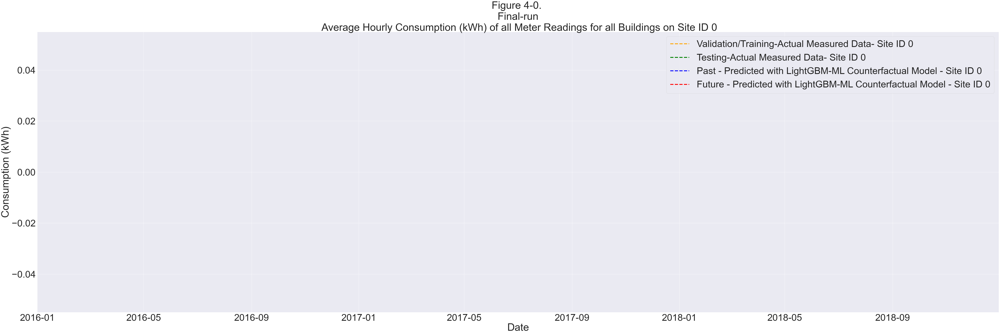

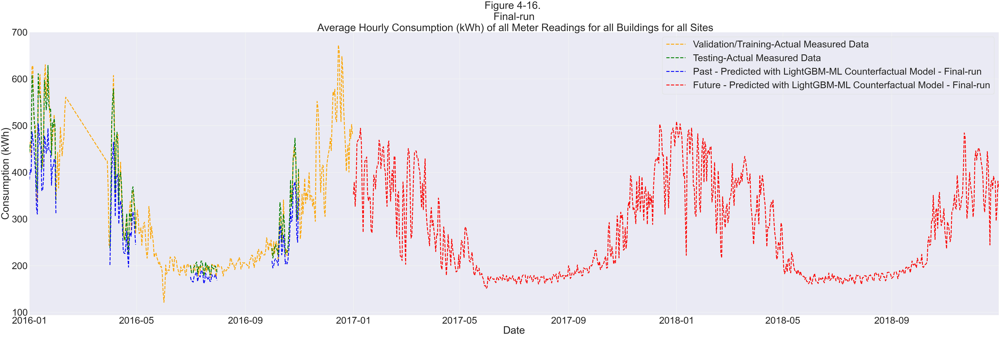

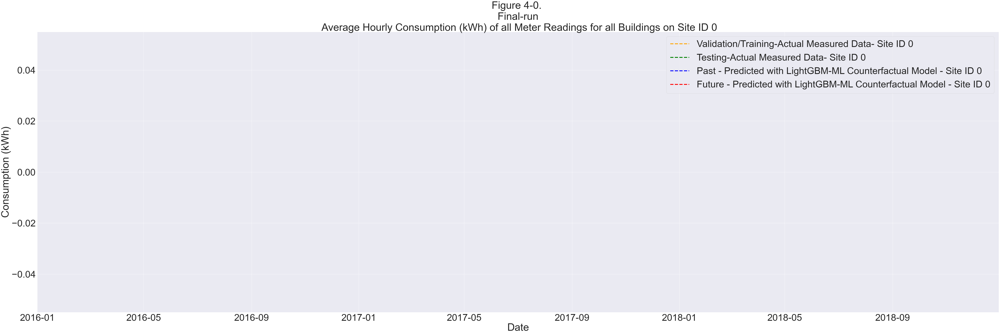

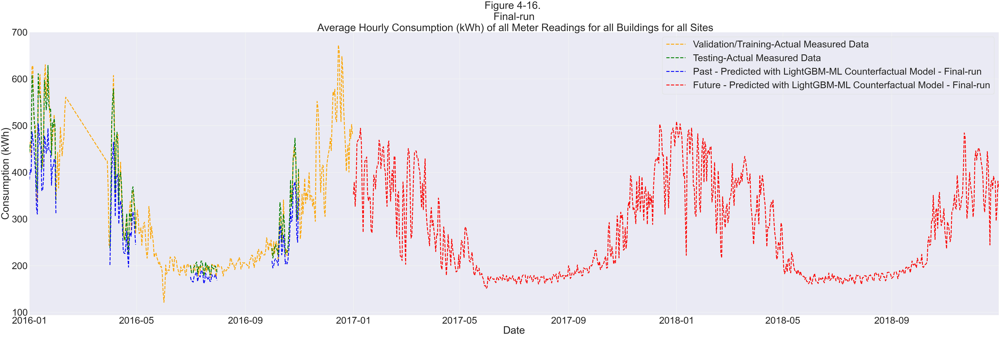

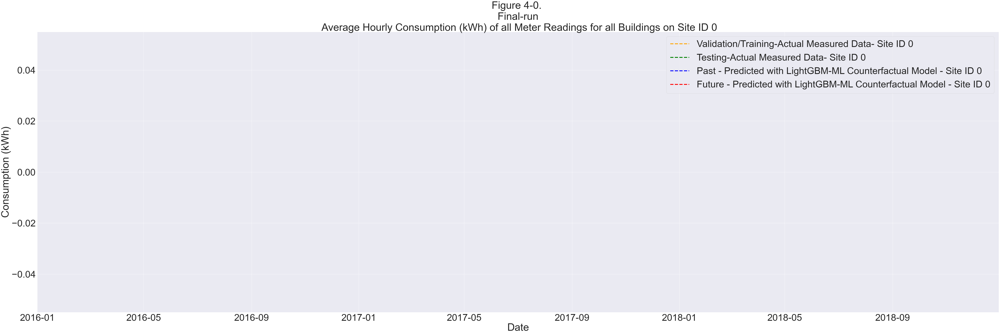

...

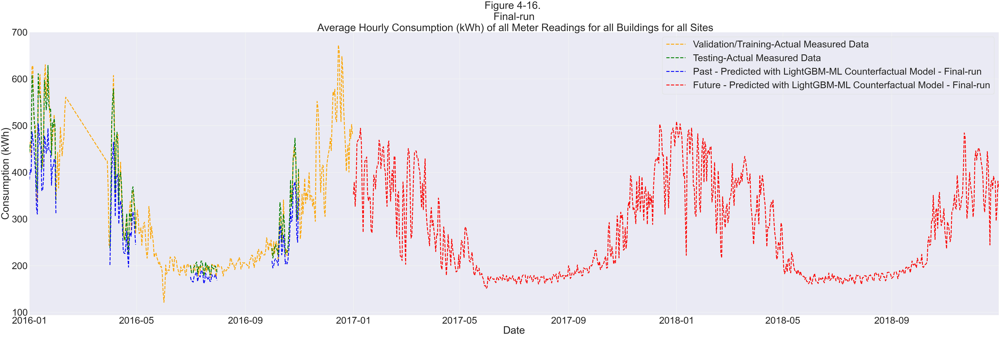

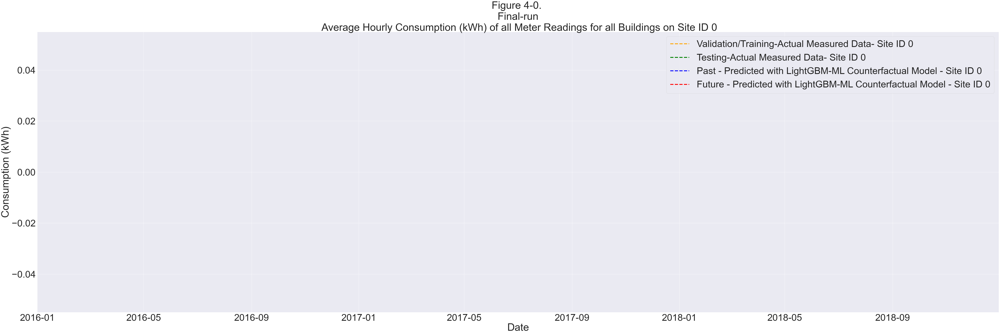

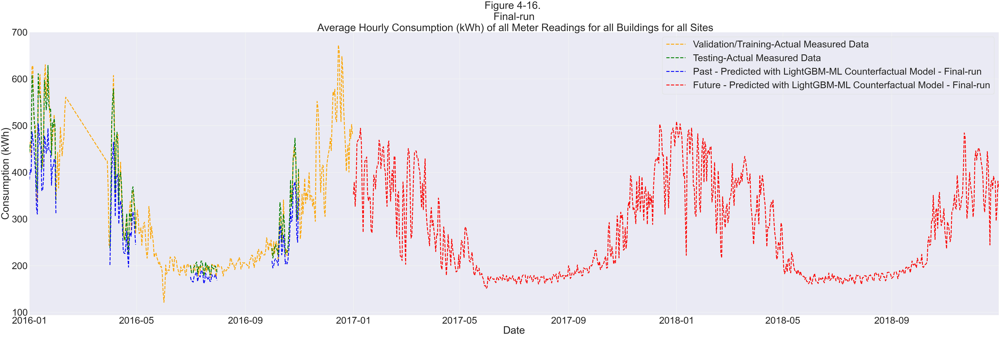

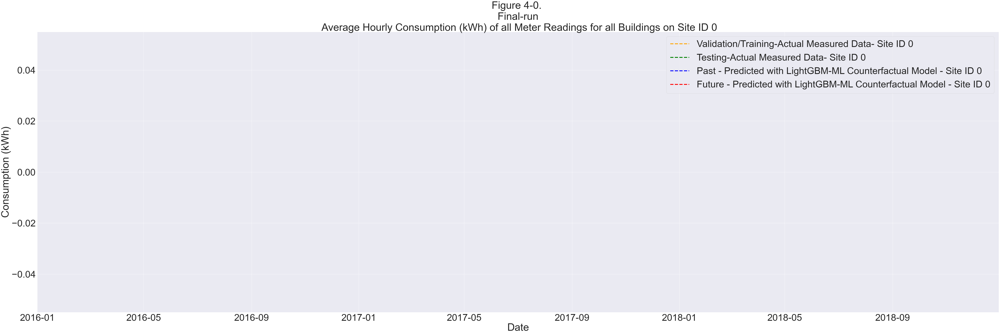

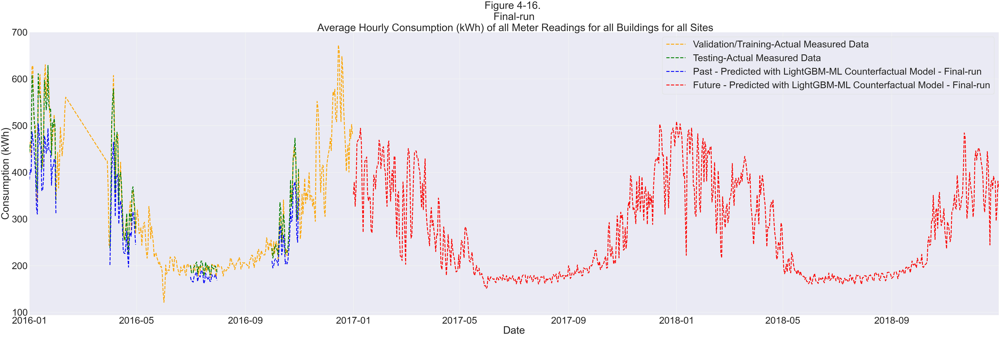

In [86]:
count=0
for Split_Number in list(Splits):  
        dummy= os.path.join(OUTPUT_split_path[count],"Site_ID_{}_submission_GBM.csv".format(count))
        dummy2 = pd.DataFrame(file_loader(dummy))
        if count == 0:
                    submission = dummy2
        else:
                    submission = pd.concat([submission,dummy2],axis=0)
        
        submission=submission.sort_values(by='row_id')
        submission=submission.reset_index()
        submission.drop(['index'],axis=1,inplace=True)
        ## Function to reduce the DF size
        def reduce_mem_usage(df, verbose=True):
            numerics = ['int16', 'int32', 'int64', 'float16', 'float32', 'float64']
            start_mem = df.memory_usage().sum() / 1024**2    
            for col in df.columns:
                col_type = df[col].dtypes
                if col_type in numerics:
                    c_min = df[col].min()
                    c_max = df[col].max()
                    if str(col_type)[:3] == 'int':
                        if c_min > np.iinfo(np.int8).min and c_max < np.iinfo(np.int8).max:
                            df[col] = df[col].astype(np.int8)
                        elif c_min > np.iinfo(np.int16).min and c_max < np.iinfo(np.int16).max:
                            df[col] = df[col].astype(np.int16)
                        elif c_min > np.iinfo(np.int32).min and c_max < np.iinfo(np.int32).max:
                            df[col] = df[col].astype(np.int32)
                        elif c_min > np.iinfo(np.int64).min and c_max < np.iinfo(np.int64).max:
                            df[col] = df[col].astype(np.int64)  
                    else:
                        if c_min > np.finfo(np.float16).min and c_max < np.finfo(np.float16).max:
                            df[col] = df[col].astype(np.float16)
                        elif c_min > np.finfo(np.float32).min and c_max < np.finfo(np.float32).max:
                            df[col] = df[col].astype(np.float32)
                        else:
                            df[col] = df[col].astype(np.float64)    
            end_mem = df.memory_usage().sum() / 1024**2
            if verbose: print('Mem. usage decreased to {:5.2f} Mb ({:.1f}% reduction)'.format(end_mem, 100 * (start_mem - end_mem) / start_mem))
            return df
        # Reduce Memory
        submission=reduce_mem_usage(submission)
        submission.to_csv(os.path.join(OUTPUT_path,"submission.csv"), 
                          index=False, 
                          float_format="%.4f")
        building = 'building_metadata.csv'
        data_train = 'train.csv'
        data_test = 'test.csv'
        building = file_loader(os.path.join(default_path,building))
        data_train = file_loader(os.path.join(default_path,data_train))
        data_test = file_loader(os.path.join(default_path,data_test))

        for Split_Number in list(Splits):  
                dummy= os.path.join(OUTPUT_split_path[count],"test_Combined_Site_ID_{}.csv".format(count))
                dummy2 = pd.DataFrame(file_loader(dummy))
                if count == 0:
                            test_Combined = dummy2
                            break
                else:
                            test_Combined = pd.concat([test_Combined,dummy2],axis=0)
                            break

        for Split_Number in list(Splits):  
                dummy= os.path.join(OUTPUT_split_path[count],"train_Combined_Site_ID_{}.csv".format(count))
                dummy2 = pd.DataFrame(file_loader(dummy))
                if count == 0:
                            train_Combined = dummy2
                            break
                else:
                            train_Combined = pd.concat([train_Combined,dummy2],axis=0)
                            break
        ## Function to reduce the DF size
        def reduce_mem_usage(df, verbose=True):
            numerics = ['int16', 'int32', 'int64', 'float16', 'float32', 'float64']
            start_mem = df.memory_usage().sum() / 1024**2    
            for col in df.columns:
                col_type = df[col].dtypes
                if col_type in numerics:
                    c_min = df[col].min()
                    c_max = df[col].max()
                    if str(col_type)[:3] == 'int':
                        if c_min > np.iinfo(np.int8).min and c_max < np.iinfo(np.int8).max:
                            df[col] = df[col].astype(np.int8)
                        elif c_min > np.iinfo(np.int16).min and c_max < np.iinfo(np.int16).max:
                            df[col] = df[col].astype(np.int16)
                        elif c_min > np.iinfo(np.int32).min and c_max < np.iinfo(np.int32).max:
                            df[col] = df[col].astype(np.int32)
                        elif c_min > np.iinfo(np.int64).min and c_max < np.iinfo(np.int64).max:
                            df[col] = df[col].astype(np.int64)  
                    else:
                        if c_min > np.finfo(np.float16).min and c_max < np.finfo(np.float16).max:
                            df[col] = df[col].astype(np.float16)
                        elif c_min > np.finfo(np.float32).min and c_max < np.finfo(np.float32).max:
                            df[col] = df[col].astype(np.float32)
                        else:
                            df[col] = df[col].astype(np.float64)    
            end_mem = df.memory_usage().sum() / 1024**2
            if verbose: print('Mem. usage decreased to {:5.2f} Mb ({:.1f}% reduction)'.format(end_mem, 100 * (start_mem - end_mem) / start_mem))
            return df  
        # Reduce Memory
        building = reduce_mem_usage(building)
        data_train = reduce_mem_usage(data_train)
        data_test = reduce_mem_usage(data_test)
        train_Combined = reduce_mem_usage(train_Combined)
        test_Combined = reduce_mem_usage(test_Combined)
        # Data Train
        data_train = data_train.merge(building, on='building_id', how='left')


        # Data Train
        data_test = data_test.merge(building, on='building_id', how='left')
        final_test_Combined=data_test.merge(submission,on='row_id',how='left')

        all_Combined=pd.concat([data_train,test_Combined],axis=0)
        all_Combined=all_Combined.sort_values(by='timestamp')
        test_Combined=test_Combined.sort_values(by='original_index')
        test_Combined=test_Combined.sort_values(by='timestamp',ascending=True)

        # upsampled daily averaged, but per hour average
        x4w=train_Combined.copy()
        x4w["timestamp"] = pd.to_datetime(x4w["timestamp"],format="%Y-%m-%d")
        x4w=x4w.groupby(['timestamp','site_id']).mean()['meter_reading'] # only groups by those
        x4w=pd.DataFrame(x4w).reset_index(level=['timestamp','site_id'])
        x4w=x4w.set_index('timestamp')
        x4w=x4w.groupby(['site_id']).resample('D').mean()
        x4w=x4w.drop(['site_id'],axis=1)
        x4w=x4w.reset_index()


        # upsampled daily averaged, but per hour average
        x1w=test_Combined.copy()
        x1w["timestamp"] = pd.to_datetime(x1w["timestamp"],format="%Y-%m-%d")
        x1w=x1w.groupby(['timestamp','site_id']).mean()['meter_reading'] # only groups by those
        x1w=pd.DataFrame(x1w).reset_index(level=['timestamp','site_id'])
        x1w=x1w.set_index('timestamp')
        x1w=x1w.groupby(['site_id']).resample('D').mean()
        x1w=x1w.drop(['site_id'],axis=1)
        x1w=x1w.reset_index()

        # upsampled daily averaged, but per hour average
        x2w=test_Combined.copy()
        x2w["timestamp"] = pd.to_datetime(x2w["timestamp"],format="%Y-%m-%d")
        x2w=x2w.groupby(['timestamp','site_id']).mean()['GBM_meter_reading'] # only groups by those
        x2w=pd.DataFrame(x2w).reset_index(level=['timestamp','site_id'])
        x2w=x2w.set_index('timestamp')
        x2w=x2w.groupby(['site_id']).resample('D').mean()
        x2w=x2w.drop(['site_id'],axis=1)
        x2w=x2w.reset_index()

        # upsampled daily averaged, but per hour average
        x3w=final_test_Combined.copy()
        x3w["timestamp"] = pd.to_datetime(x3w["timestamp"],format="%Y-%m-%d")
        x3w=x3w.groupby(['timestamp','site_id']).mean()['meter_reading'] # only groups by those
        x3w=pd.DataFrame(x3w).reset_index(level=['timestamp','site_id'])
        x3w=x3w.set_index('timestamp')
        x3w=x3w.groupby(['site_id']).resample('D').mean()
        x3w=x3w.drop(['site_id'],axis=1)
        x3w=x3w.reset_index()

        run_type='Final-run'

        def site_id_plot(run_type,
                          x4w,
                          x1w,
                         x2w,
                         x3w,
                         Fig_num,
                         Alg_name,
                         Alg_col_name,Split_Number_i):


            count=Split_Number_i
            sns.set(font_scale = 5)
            fig=plt.subplots(figsize=[100,30])
            plt.title('Figure 4-{}. \n {} \n Average Hourly Consumption (kWh)'
                      ' of all Meter Readings for '
                      'all Buildings on Site ID {}'. format(Split_Number_i, run_type,Split_Number_i))
            plt.ylabel('Consumption (kWh)')
            plt.xlabel('Date')

            plt.plot(    x4w['timestamp']
                     [(x4w['site_id']==count)], x4w['meter_reading']
                     [(x4w['site_id']==count)],color='orange',linewidth=5,linestyle='--')



            plt.plot(    x1w['timestamp']
                     [(x1w['site_id']==count)], x1w['meter_reading']
                     [(x1w['site_id']==count)],color='green',linewidth=5,linestyle='--')


            plt.plot(    x2w['timestamp']
                     [(x2w['site_id']==count)], x2w['GBM_meter_reading']
                     [(x2w['site_id']==count)],color='blue',linewidth=5,linestyle='--')

            plt.plot(    x3w['timestamp']
                     [(x3w['site_id']==count)], x3w['meter_reading']
                     [(x3w['site_id']==count)],color='red',linewidth=5,linestyle='--')

            plt.legend(['Validation/Training-Actual Measured Data- Site ID {}'.format(count),
                        'Testing-Actual Measured Data- Site ID {}'.format(count),
                       'Past - Predicted with {}-ML Counterfactual Model - Site ID {}'.format(Alg_name, count),
                       'Future - Predicted with {}-ML Counterfactual Model - Site ID {}'.format(Alg_name, count)])
            plt.xlim(min(x4w['timestamp']),max(x3w['timestamp']))
            plot_fig = os.path.join(figures_path[Split_Number_i],
                                    'Figure_4-{}-{}-Site ID {}.png'.format(Split_Number_i,
                                                                                        Fig_num,
                                                                                  Split_Number_i))
            plt.savefig(plot_fig,dpi=100,bbox_inches='tight')



        Split_Number_i=0
        for Split_Number in list(Splits):  

            i=0
            site_id_plot(run_type,
                          x4w,x1w,x2w,x3w,'{}'.format(i),
                          'LightGBM','meter_reading',Split_Number_i)
            Split_Number_i+=1
            break

        # upsampled daily averaged, but per hour average
        x4a=train_Combined.copy()
        x4a["timestamp"] = pd.to_datetime(x4a["timestamp"],format="%Y-%m-%d")
        x4a=x4a.groupby(['timestamp']).mean()['meter_reading'] # only groups by those
        x4a=pd.DataFrame(x4a).reset_index(level=['timestamp'])
        x4a=x4a.set_index('timestamp')
        x4a=x4a.resample('D').mean()
        x4a=x4a.reset_index()

        # upsampled daily averaged, but per hour average
        x1a=test_Combined.copy()
        x1a["timestamp"] = pd.to_datetime(x1a["timestamp"],format="%Y-%m-%d")
        x1a=x1a.groupby(['timestamp']).mean()['meter_reading'] # only groups by those
        x1a=pd.DataFrame(x1a).reset_index(level=['timestamp'])
        x1a=x1a.set_index('timestamp')
        x1a=x1a.resample('D').mean()
        x1a=x1a.reset_index()


        # upsampled daily averaged, but per hour average
        x2a=test_Combined.copy()
        x2a["timestamp"] = pd.to_datetime(x2a["timestamp"],format="%Y-%m-%d")
        x2a=x2a.groupby(['timestamp']).mean()['GBM_meter_reading'] # only groups by those
        x2a=pd.DataFrame(x2a).reset_index(level=['timestamp'])
        x2a=x2a.set_index('timestamp')
        x2a=x2a.resample('D').mean()
        x2a=x2a.reset_index()

        # upsampled daily averaged, but per hour average
        x3a=final_test_Combined.copy()
        x3a["timestamp"] = pd.to_datetime(x3a["timestamp"],format="%Y-%m-%d")
        x3a=x3a.groupby(['timestamp']).mean()['meter_reading'] # only groups by those
        x3a=pd.DataFrame(x3a).reset_index(level=['timestamp'])
        x3a=x3a.set_index('timestamp')
        x3a=x3a.resample('D').mean()
        x3a=x3a.reset_index()

        def all_plot(run_type,
                          x4a,
                          x1a,
                         x2a,
                         x3a,
                         Alg_name,
                         Alg_col_name):


            count=Split_Number_i
            sns.set(font_scale = 5)
            fig=plt.subplots(figsize=[100,30])
            plt.title('Figure 4-16. \n {} \n Average Hourly Consumption (kWh)'
                      ' of all Meter Readings for all Buildings for all Sites'. format(run_type))
            plt.ylabel('Consumption (kWh)')
            plt.xlabel('Date')

            plt.plot(    x4a['timestamp'], x4a['meter_reading'],color='orange',linewidth=5,linestyle='--')



            plt.plot(    x1a['timestamp'], x1a['meter_reading'],color='green',linewidth=5,linestyle='--')


            plt.plot(    x2a['timestamp'], x2a['GBM_meter_reading'],color='blue',linewidth=5,linestyle='--')

            plt.plot(    x3a['timestamp'], x3a['meter_reading'],color='red',linewidth=5,linestyle='--')

            plt.legend(['Validation/Training-Actual Measured Data',
                        'Testing-Actual Measured Data',
                       'Past - Predicted with {}-ML Counterfactual Model - {}'.format(Alg_name, run_type),
                       'Future - Predicted with {}-ML Counterfactual Model - {}'.format(Alg_name, run_type)])
            plt.xlim(min(x4a['timestamp']),max(x3a['timestamp']))
            plot_fig = os.path.join(OUTPUT_path,
                                    'Figure_4-16-All-{}.png'.format(run_type))
            plt.savefig(plot_fig,dpi=100,bbox_inches='tight')


        all_plot(run_type,
                          x4a,x1a,x2a,x3a,
                          'LightGBM','meter_reading')
        count+=1